# Remove "maneuvering" not flagged in the raw data

Author: Brian Green (briangre@stanford.edu)

In [1]:
import pandas as pd
import numpy as np
import warnings
import matplotlib.pyplot as plt
from notebook_utils import before_and_after_segments
from tqdm.notebook import tqdm
from scipy import interpolate
import scipy.signal
import xarray

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    tqdm.pandas()

%matplotlib inline

### Load the data from the previous step

In [2]:
flights = pd.read_feather('4_flights_nativetime.feather')
flights

,flight_id,time,latitude,longitude,altitude,pressure,wind_u,wind_v,T_cosmic,dTdz_cosmic,N_cosmic,suspicious_motion,segment_id,altitude_spike
0,F-011,2012-10-10 22:43:48.200,37.488174,-120.358887,21725.0,42.70,5.427,0.109,-60.406238,0.001952,47.0,0,9,0
1,F-011,2012-10-10 22:46:48.200,37.488205,-120.348259,21723.0,42.83,5.317,-0.068,-60.410142,0.001951,47.0,0,9,0
2,F-011,2012-10-10 22:49:48.210,37.487953,-120.337318,21720.0,42.76,5.132,-0.132,-60.415993,0.001949,47.0,0,9,0
3,F-011,2012-10-10 22:52:48.210,37.487778,-120.327438,21728.0,42.71,4.914,0.075,-60.400377,0.001954,47.0,0,9,0
4,F-011,2012-10-10 22:55:48.210,37.488194,-120.317383,21733.0,42.70,4.717,0.280,-60.390596,0.001957,47.0,0,9,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43092168,LN-325,2021-03-06 11:37:20.000,11.197386,-135.131277,17415.5,84.49,-2.421,4.332,-78.845204,0.000700,282.0,0,270216,0
43092169,LN-325,2021-03-06 11:38:20.000,11.199723,-135.132479,17411.7,84.52,-2.446,4.314,-78.845070,0.000672,281.0,0,270216,0
43092170,LN-325,2021-03-06 11:38:33.000,11.200217,-135.132738,17413.3,84.51,-2.472,4.336,-78.844004,0.000675,281.0,0,270216,0
43092171,LN-325,2021-03-06 11:39:20.000,11.202002,-135.133763,17420.1,84.42,-2.513,4.351,-78.839396,0.000688,281.0,0,270216,0


### Look for segments with periods of high altitude variability, indicative of maneuvering, using multiple methods

In [5]:
def segment_alt_stdev(segment): # This code calculates a running standard deviation of the balloon altitude
    
    chunk_length = 31 # must be an odd number
    altitude = np.array(segment.altitude)
    segment_n = segment.shape[0]
    altitudes_shifted = np.zeros(shape=(segment_n,chunk_length))
    altitudes_shifted[:,:int((chunk_length-1)/2)] = altitude[-1]
    altitudes_shifted[:,int((chunk_length-1)/2):] = altitude[0]
    for i in np.arange(chunk_length):
        shift_amount = i - int((chunk_length-1)/2)
        ind1 = max(0,shift_amount)
        ind2 = min(segment_n,segment_n+shift_amount)
        ind3 = max(0,-shift_amount)
        ind4 = min(segment_n,segment_n-shift_amount)
        altitudes_shifted[ind1:ind2,i] = altitude[ind3:ind4]
    segment.alt_stdev = np.std(altitudes_shifted, axis=1)
    
    return segment

flights['alt_stdev'] = 0
flights = flights.groupby('segment_id').progress_apply(segment_alt_stdev).reset_index(drop=True)

  0%|          | 0/124073 [00:00<?, ?it/s]

Number of segments: 105


/var/folders/dw/3jtpv5j16bv77dfbt2nw04780000gp/T/ipykernel_80076/2122317259.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15,3))


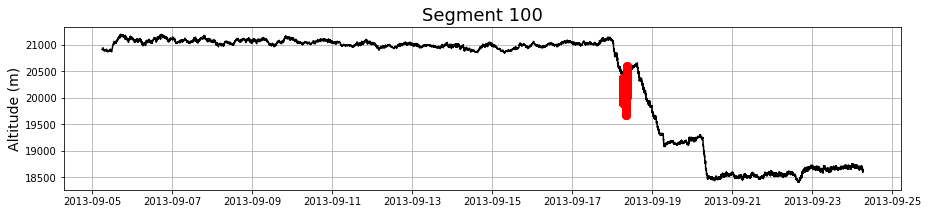

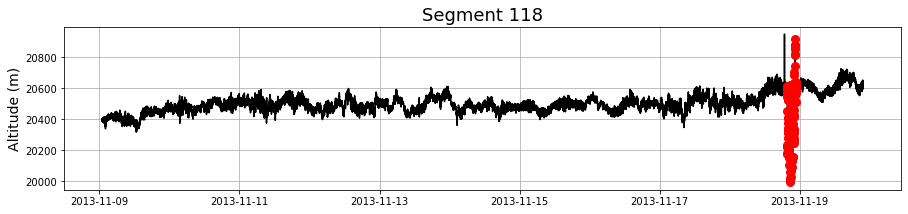

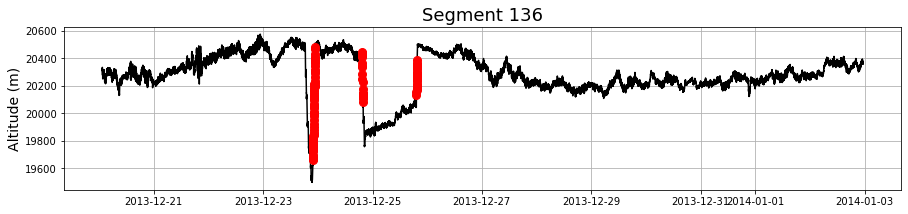

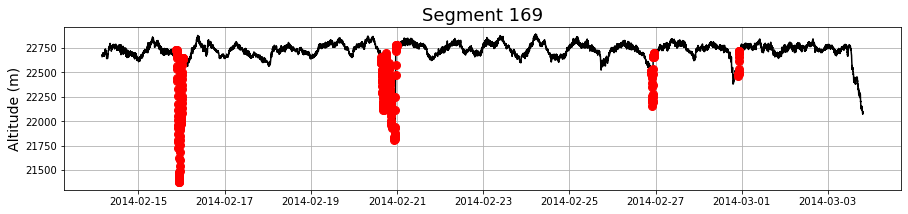

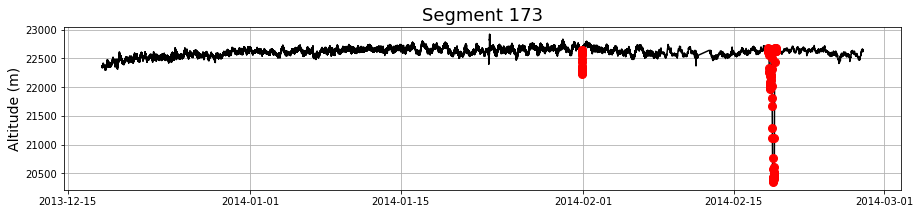

...

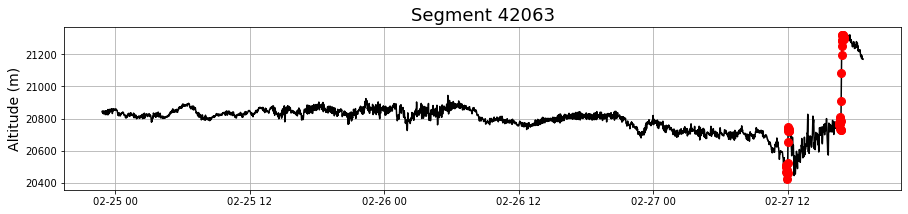

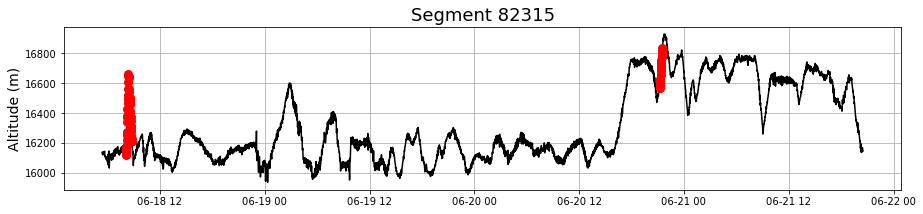

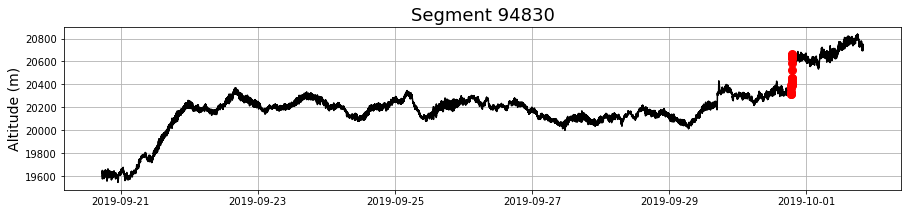

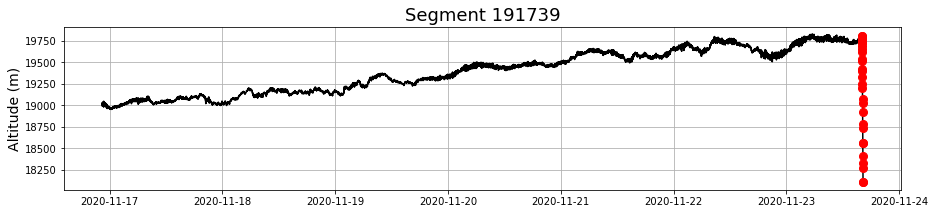

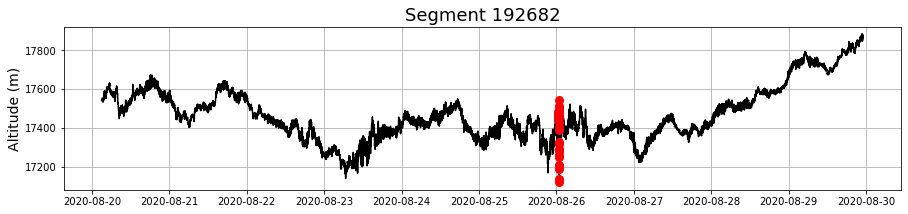

In [6]:
# Flights that have instances of the std exceeding the threshold
sigma_thresh = 100 # (m)
flights['exceeds_thresh'] = 0
flights.loc[flights.alt_stdev > sigma_thresh, 'exceeds_thresh'] = 1

# Just look at segments longer than two days
min_length = pd.Timedelta('2 days')
segments_to_select = flights.groupby('segment_id').apply(lambda f: f.time.iloc[-1] - f.time.iloc[0])
segments_to_select = segments_to_select[segments_to_select > min_length]
flights_2days = flights[flights.segment_id.isin(segments_to_select.index)]
interesting_segs = flights_2days.groupby('segment_id').apply(lambda f: f.exceeds_thresh.sum())
interesting_segs = interesting_segs[interesting_segs > 0]
segment_ids = np.array(interesting_segs.index.unique())
n_segments = interesting_segs.index.nunique()
print('Number of segments:', n_segments)

# Plot all of these segments, highlighting the altitude jumps
for i in np.arange(n_segments):
    
    segment = flights_2days[flights_2days.segment_id == segment_ids[i]].copy()
    temp = segment[segment.alt_stdev > sigma_thresh]
    
    plt.figure(figsize=(15,3))
    plt.plot(segment.time,segment.altitude,'k')
    plt.plot(temp.time,temp.altitude,'ro',markersize=8)
    plt.grid()
    plt.title(f'Segment {segment_ids[i]}', fontsize=18)
    plt.ylabel('Altitude (m)', fontsize=14);

Number of segments: 195


/var/folders/dw/3jtpv5j16bv77dfbt2nw04780000gp/T/ipykernel_57051/4118265803.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15,3))


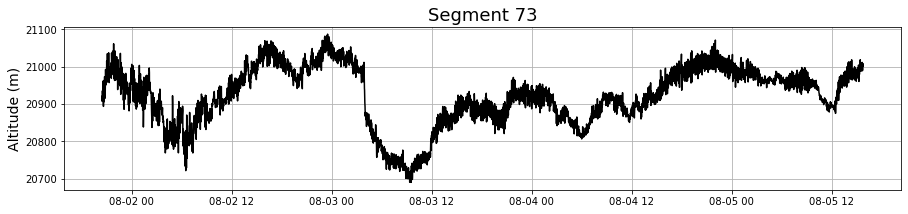

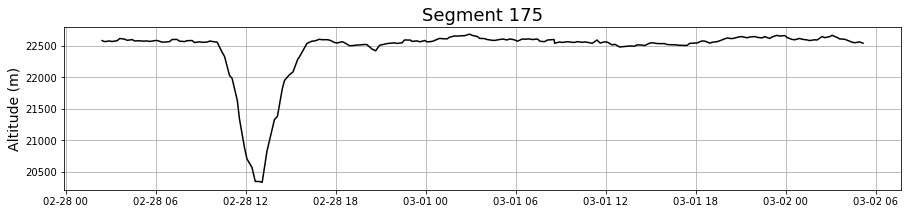

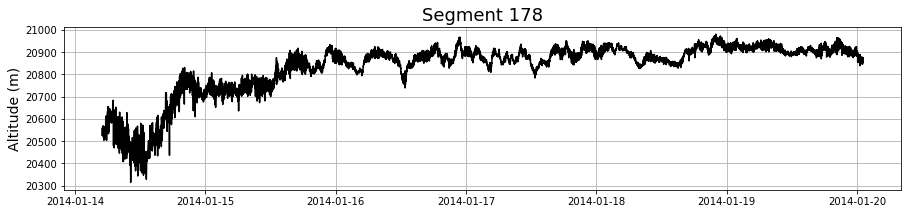

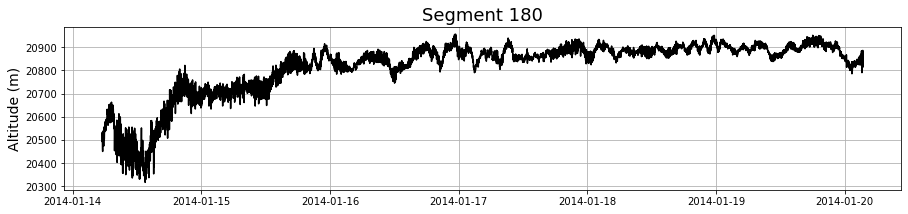

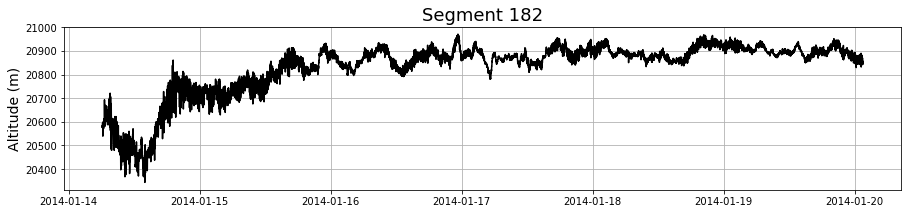

...

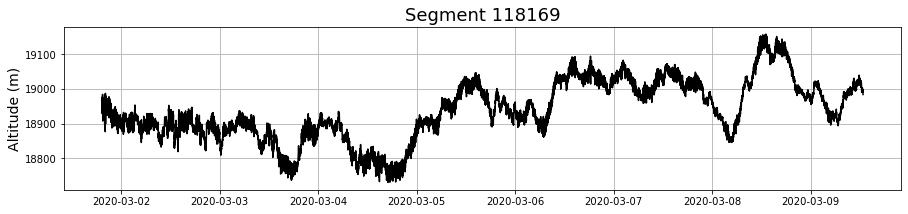

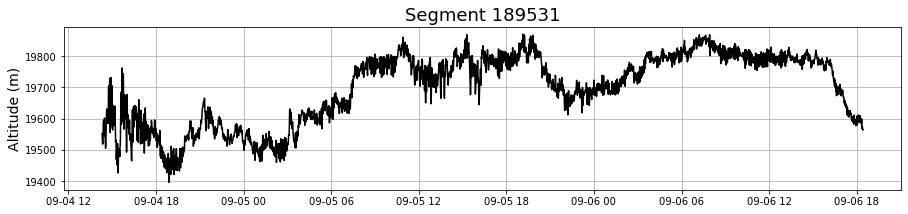

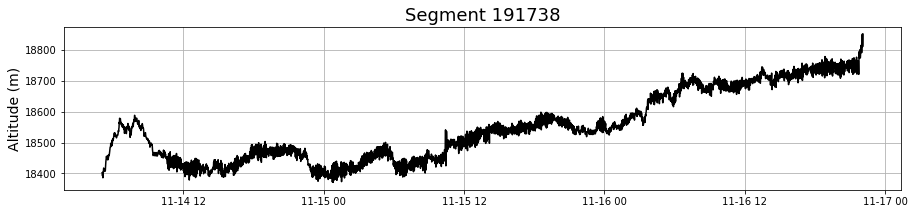

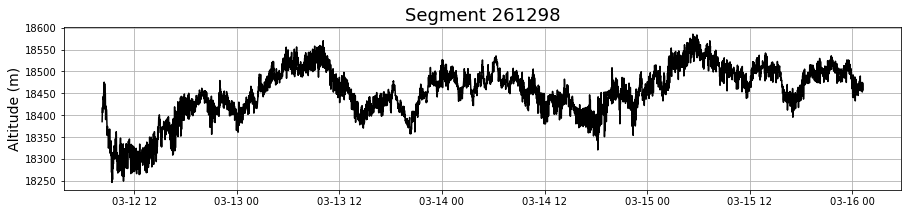

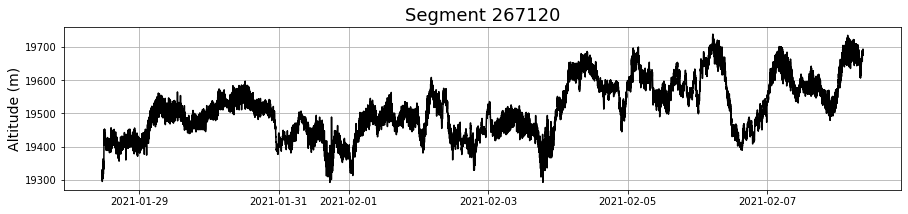

In [13]:
# Look for takeoffs by checking for large altitude changes at the beginning of each segment

# Just look at segments longer than two days
min_length = pd.Timedelta('2 days')
segments_to_select = flights.groupby('segment_id').apply(lambda f: f.time.iloc[-1] - f.time.iloc[0])
segments_to_select = segments_to_select[segments_to_select > min_length]
flights_2days = flights[flights.segment_id.isin(segments_to_select.index)]
interesting_segs = flights_2days.groupby('segment_id').apply(lambda f: f.altitude.iloc[:60].max() - 
                                                             f.altitude.iloc[:60].min())
interesting_segs = interesting_segs[interesting_segs > 100]
segment_ids = np.array(interesting_segs.index.unique())
n_segments = interesting_segs.index.nunique()
print('Number of segments:', n_segments)

# Plot all of these segments
for i in np.arange(n_segments):
    
    segment = flights_2days[flights_2days.segment_id == segment_ids[i]].copy()
    
    plt.figure(figsize=(15,3))
    plt.plot(segment.time,segment.altitude,'k')
    plt.grid()
    plt.title(f'Segment {segment_ids[i]}', fontsize=18)
    plt.ylabel('Altitude (m)', fontsize=14);

Number of segments: 207


/var/folders/dw/3jtpv5j16bv77dfbt2nw04780000gp/T/ipykernel_57051/31086734.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15,3))


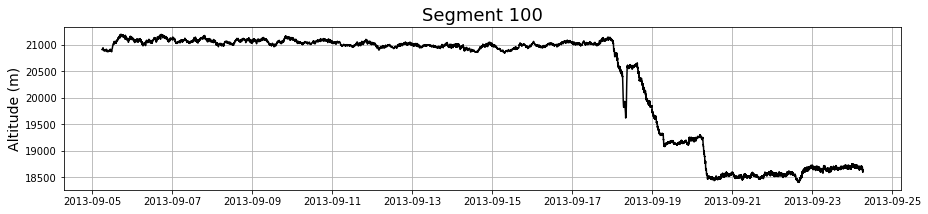

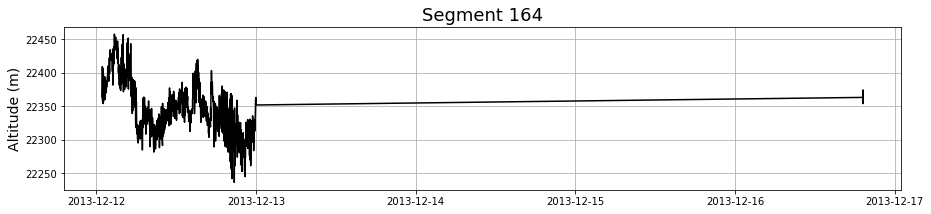

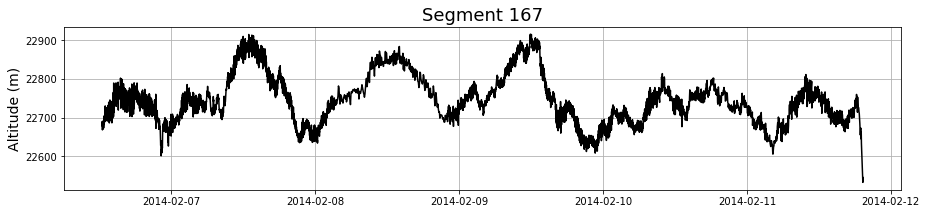

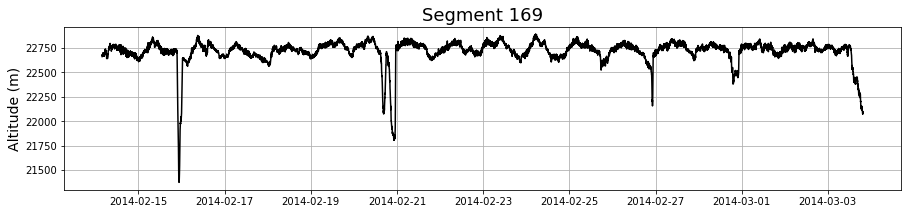

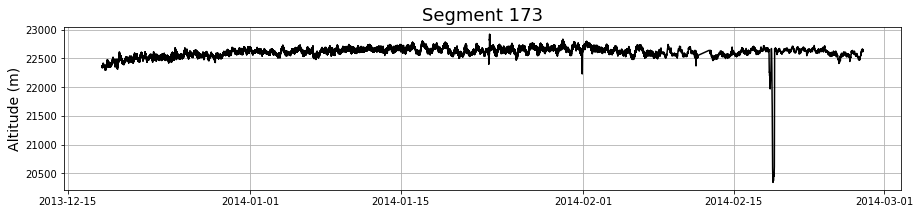

...

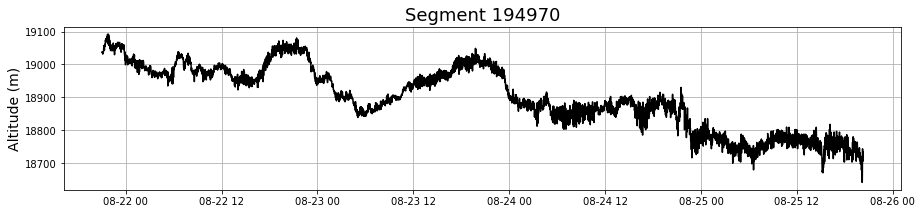

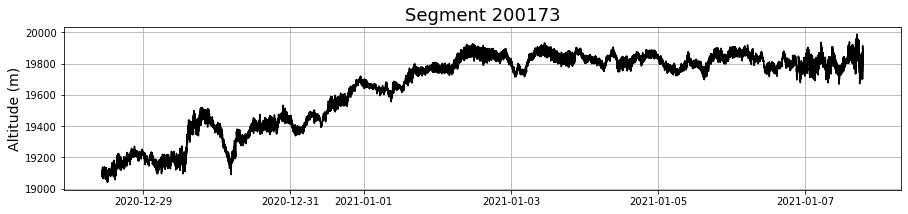

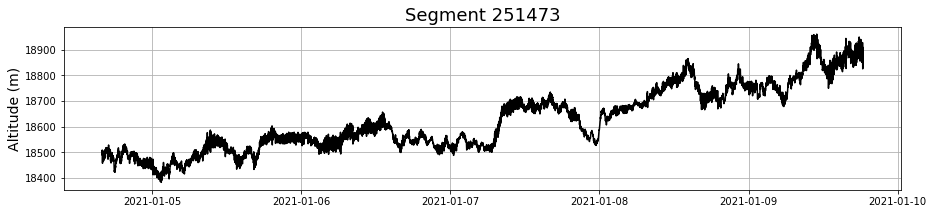

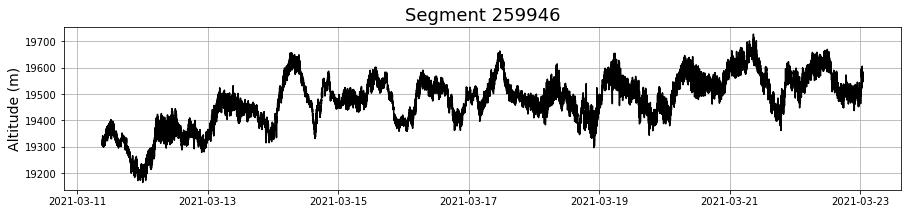

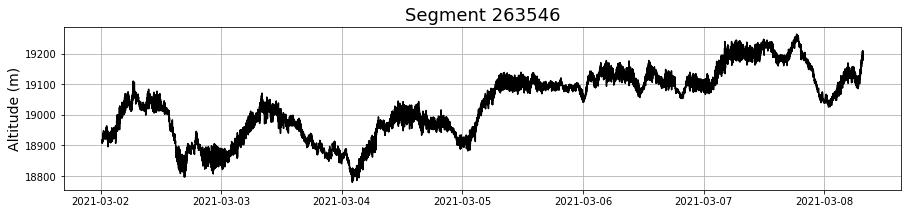

In [14]:
# Look for landings by checking for large altitude changes at the end of each segment

# Just look at segments longer than two days
min_length = pd.Timedelta('2 days')
segments_to_select = flights.groupby('segment_id').apply(lambda f: f.time.iloc[-1] - f.time.iloc[0])
segments_to_select = segments_to_select[segments_to_select > min_length]
flights_2days = flights[flights.segment_id.isin(segments_to_select.index)]
interesting_segs = flights_2days.groupby('segment_id').apply(lambda f: f.altitude.iloc[-60:].max() - 
                                                             f.altitude.iloc[-60:].min())
interesting_segs = interesting_segs[interesting_segs > 100]
segment_ids = np.array(interesting_segs.index.unique())
n_segments = interesting_segs.index.nunique()
print('Number of segments:', n_segments)

# Plot all of these segments
for i in np.arange(n_segments):
    
    segment = flights_2days[flights_2days.segment_id == segment_ids[i]].copy()
    
    plt.figure(figsize=(15,3))
    plt.plot(segment.time,segment.altitude,'k')
    plt.grid()
    plt.title(f'Segment {segment_ids[i]}', fontsize=18)
    plt.ylabel('Altitude (m)', fontsize=14);

Number of segments: 384


/var/folders/dw/3jtpv5j16bv77dfbt2nw04780000gp/T/ipykernel_57051/1219093893.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15,3))


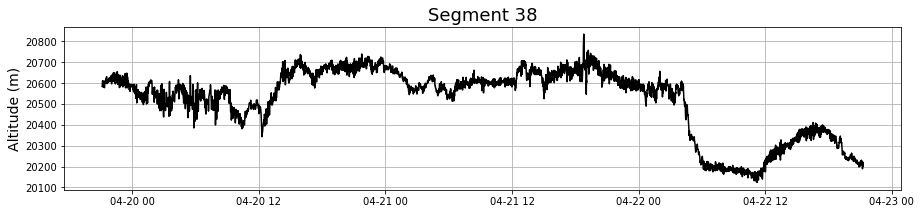

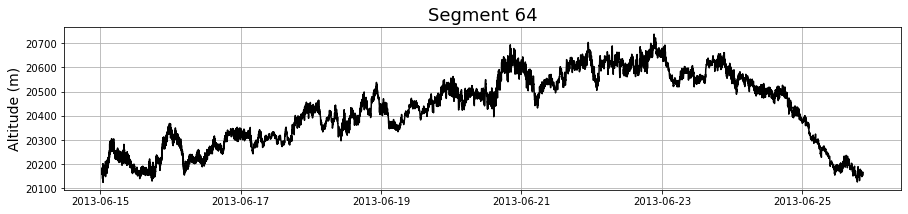

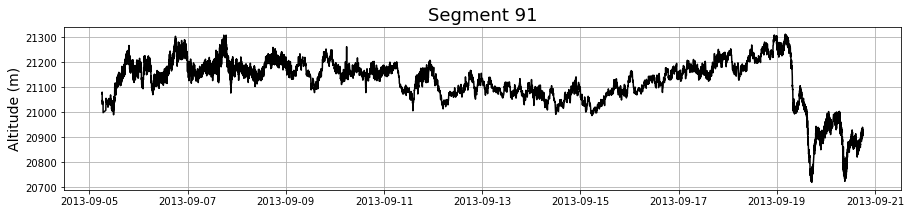

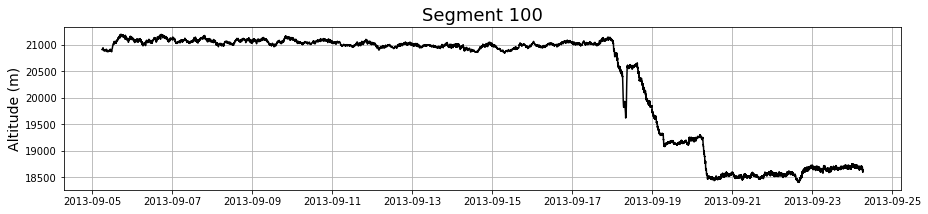

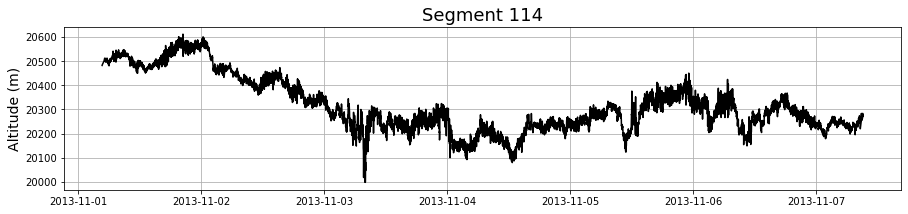

...

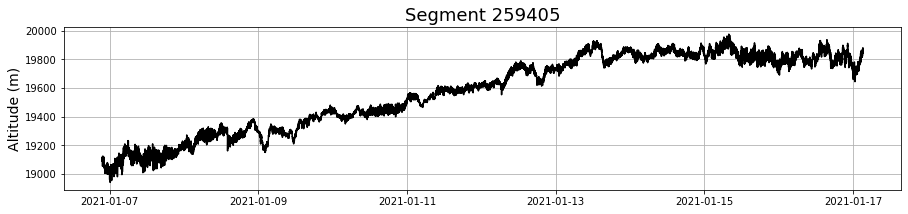

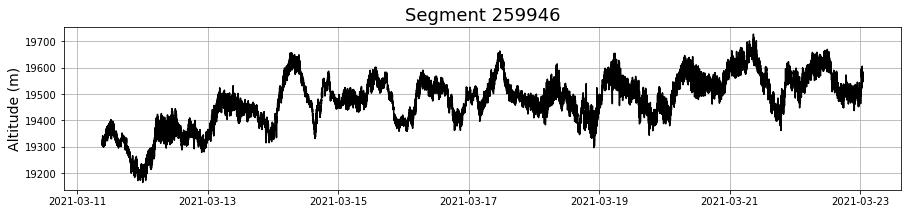

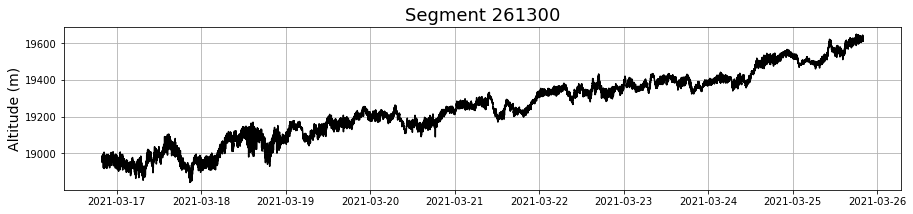

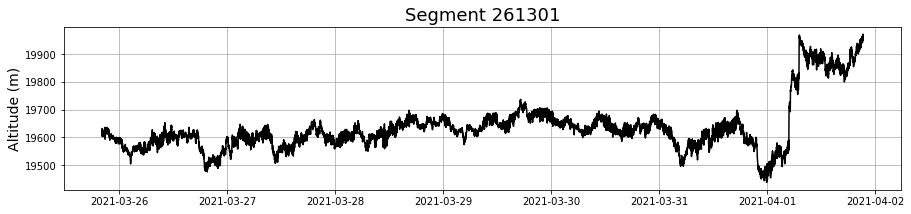

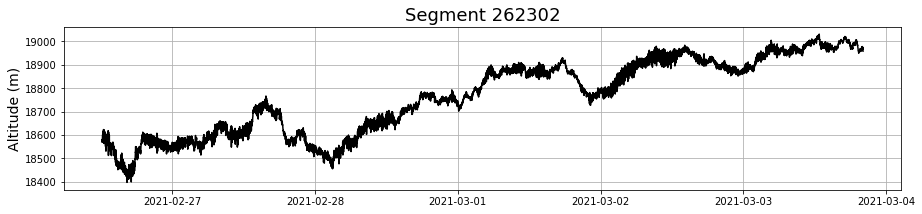

In [15]:
# Look for segments with large altitude ranges

# Just look at segments longer than two days
min_length = pd.Timedelta('2 days')
segments_to_select = flights.groupby('segment_id').apply(lambda f: f.time.iloc[-1] - f.time.iloc[0])
segments_to_select = segments_to_select[segments_to_select > min_length]
flights_2days = flights[flights.segment_id.isin(segments_to_select.index)]
interesting_segs = flights_2days.groupby('segment_id').apply(lambda f: f.altitude.max() - f.altitude.min())
interesting_segs = interesting_segs[interesting_segs > 500]
segment_ids = np.array(interesting_segs.index.unique())
n_segments = interesting_segs.index.nunique()
print('Number of segments:', n_segments)

# Plot all of these segments
for i in np.arange(n_segments):
    
    segment = flights_2days[flights_2days.segment_id == segment_ids[i]].copy()
    
    plt.figure(figsize=(15,3))
    plt.plot(segment.time,segment.altitude,'k')
    plt.grid()
    plt.title(f'Segment {segment_ids[i]}', fontsize=18)
    plt.ylabel('Altitude (m)', fontsize=14);

### Look at segments with smaller (100-500m) altitude jumps that might be maneuvering

I'm calculating and plotting the Eulerian pressure anomaly, because if the balloon motion is due to GWs, altitude and Eulerian pressure anomalies should be same-signed.

/var/folders/dw/3jtpv5j16bv77dfbt2nw04780000gp/T/ipykernel_74386/1115041259.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  segment['dt'] = segment.time.diff()/pd.Timedelta(1, 'seconds')
/var/folders/dw/3jtpv5j16bv77dfbt2nw04780000gp/T/ipykernel_74386/1115041259.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  segment['w'] = segment.altitude.diff()/segment.dt
/var/folders/dw/3jtpv5j16bv77dfbt2nw04780000gp/T/ipykernel_74386/1115041259.py:15: SettingWithCopyWarning: 
A value is trying to be set on a co

(nan, nan, 2014)

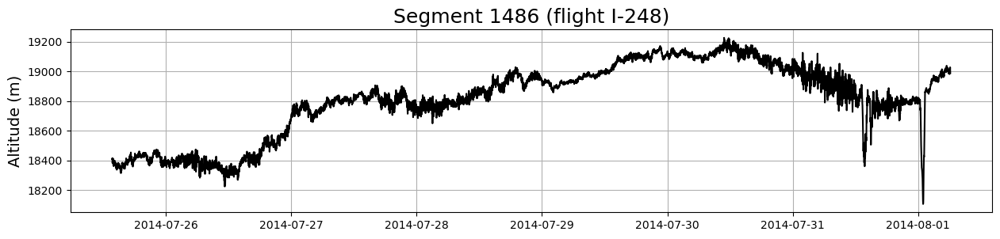

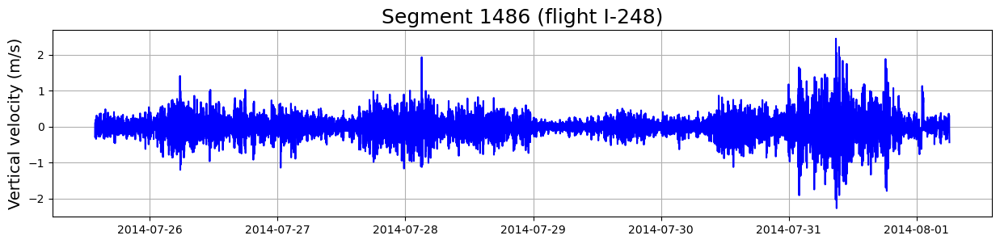

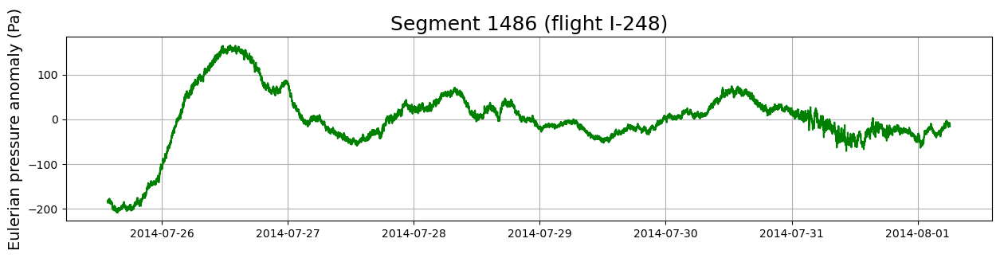

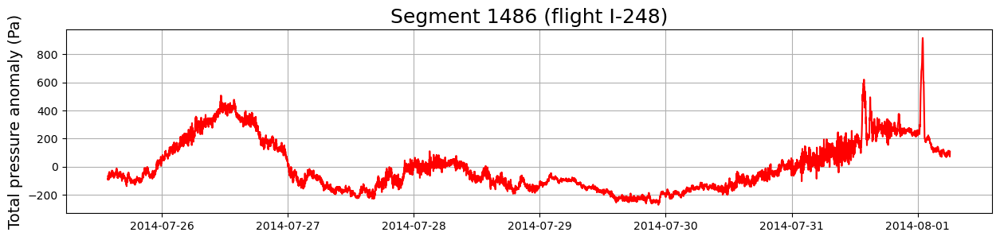

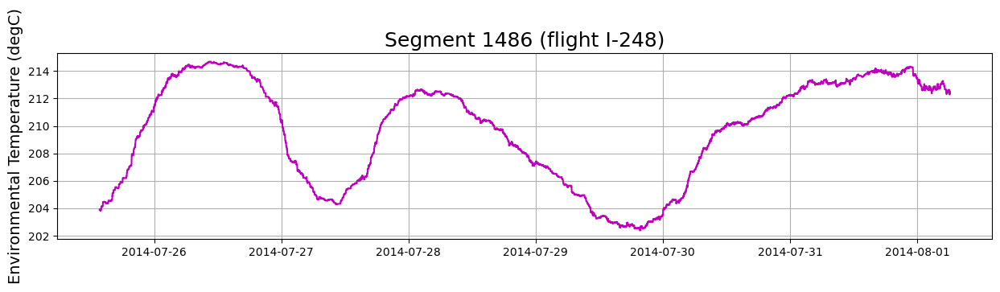

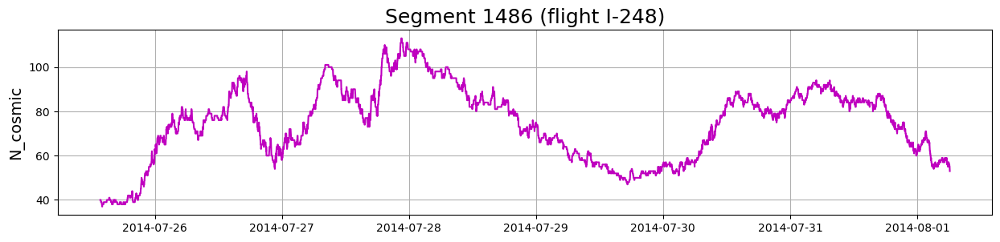

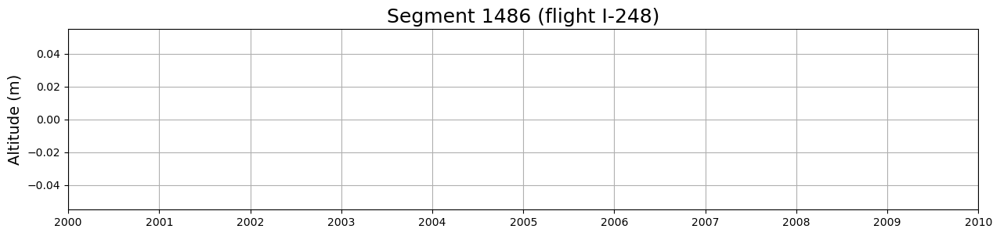

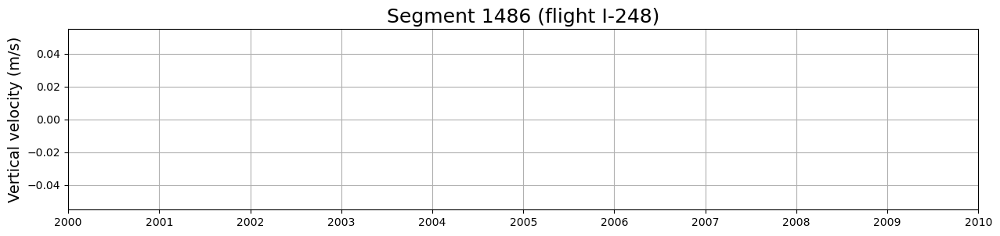

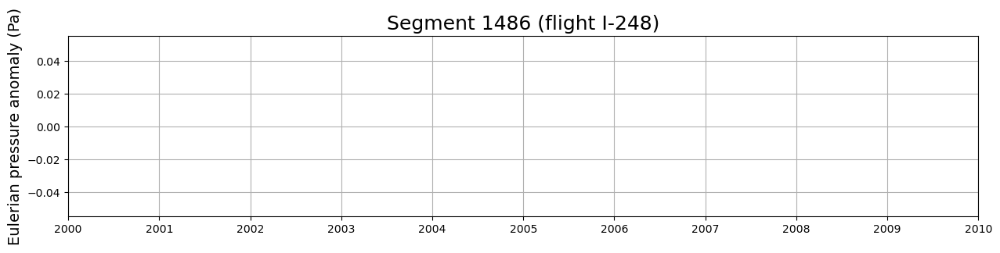

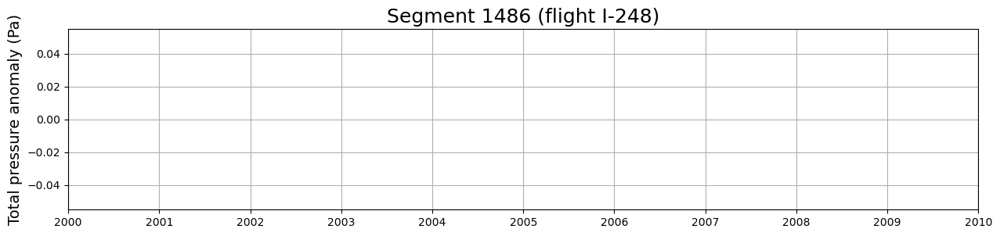

In [5]:
# Look at one segment
segment_id = 1486
segment = flights[flights.segment_id == segment_id]
segment['dt'] = segment.time.diff()/pd.Timedelta(1, 'seconds')
segment['w'] = segment.altitude.diff()/segment.dt

# Calculate the Eulerian pressure perturbation
# Remember: pressure uncertainty is +/- 100 Pa
pt = 100*np.array(segment.pressure)
T_env = np.array(segment.T_cosmic) + 273.15 # COSMIC temperatures are in degrees Celsius; convert to Kelvin
N_cosmic = np.array(segment.N_cosmic)
T_env[N_cosmic == 0] = np.nan
altitude = np.array(segment.altitude)
rho_bar = np.nanmean(pt/(287*T_env))
segment['pt'] = scipy.signal.detrend(pt)
delta_b = scipy.signal.detrend(altitude)
segment['p'] = segment.pt + rho_bar*9.806*delta_b # VH14 Eq. 21

plt.figure(figsize=(15,3))
plt.plot(segment.time,segment.altitude,'k')
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Altitude (m)', fontsize=14);

plt.figure(figsize=(15,3))
plt.plot(segment.time,segment.w,'b')
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Vertical velocity (m/s)', fontsize=14);

plt.figure(figsize=(15,3))
plt.plot(segment.time,segment.p,'g')
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Eulerian pressure anomaly (Pa)', fontsize=14);

plt.figure(figsize=(15,3))
plt.plot(segment.time,segment.pt,'r')
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Total pressure anomaly (Pa)', fontsize=14);

plt.figure(figsize=(15,3))
plt.plot(segment.time,T_env,'m')
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Environmental Temperature (degC)', fontsize=14);

plt.figure(figsize=(15,3))
plt.plot(segment.time,segment.N_cosmic,'m')
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('N_cosmic', fontsize=14);

## Zoom in on the spike, marking its location to be referenced later

## 270099: +0.9 m/s
## No Eulerian pressure anomaly
#time_start = np.datetime64('2021-03-08 06:00')
#time_stop =  np.datetime64('2021-03-08 12:00')

## 267823: +1 m/s
## No Eulerian pressure anomaly
#time_start = np.datetime64('2021-01-20 06:00')
#time_stop =  np.datetime64('2021-01-20 12:00')

## 261301: +1.1 m/s
## No Eulerian pressure anomaly
#time_start = np.datetime64('2021-04-01 02:00')
#time_stop =  np.datetime64('2021-04-01 08:00')

## 199048: +1.6 m/s
## No Eulerian pressure anomaly
#time_start = np.datetime64('2020-10-05 18:00')
#time_stop =  np.datetime64('2020-10-06 00:00')

## 94830 (two jumps): +0.75, +1.3 m/s
## Two smaller 100m jumps separated by ~30 minutes
## No Eulerian pressure anomaly
#time_start = np.datetime64('2019-09-29 14:00')
#time_stop =  np.datetime64('2019-09-29 20:00')
## No Eulerian pressure anomaly
#time_start = np.datetime64('2019-09-30 16:00')
#time_stop =  np.datetime64('2019-09-30 22:00')

## 55810: +0.75 m/s
## No Eulerian pressure anomaly
#time_start = np.datetime64('2018-10-17 00:00')
#time_stop =  np.datetime64('2018-10-17 06:00')

## 50898: +1.3 m/s
## No Eulerian pressure anomaly
#time_start = np.datetime64('2018-05-22 18:00')
#time_stop =  np.datetime64('2018-05-22 23:00')

## 42337: +0.75 m/s
## No Eulerian pressure anomaly
#time_start = np.datetime64('2018-01-07 06:00')
#time_stop =  np.datetime64('2018-01-07 12:00')

## 42063: +3 m/s
## There IS an Eulerian pressure anomaly, it's the right sign and about 
## 1/20th the magnitude of the total pressure anomaly
## This small fraction, and because the altitude jump is so large,
## convinced me to delete this jump
#time_start = np.datetime64('2017-02-27 12:00')
#time_stop =  np.datetime64('2017-02-27 18:00')

## 31210: +0.7 m/s
## No Eulerian pressure anomaly
#time_start = np.datetime64('2017-06-25 08:00')
#time_stop =  np.datetime64('2017-06-25 14:00')

## 22800: +2.2 m/s
## No Eulerian pressure anomaly
#time_start = np.datetime64('2017-06-17 01:00')
#time_stop =  np.datetime64('2017-06-17 07:00')

## 18233: +1.6 m/s
## No Eulerian pressure anomaly
#time_start = np.datetime64('2017-03-05 03:00')
#time_stop =  np.datetime64('2017-03-05 09:00')

# 16764: +1.7 m/s
# There IS an Eulerian pressure anomaly, it's the right sign and about 
# 3/20th the magnitude of the total pressure anomaly
# This > 1/10th fraction, and because the altitude jump is of a similar magnitude
# to the altitude variability in the rest of the segment, convinced me
# to NOT delete this jump
time_start = np.datetime64('2017-03-08 04:00')
time_stop =  np.datetime64('2017-03-08 10:00')

## 15907: +1.6 m/s
## No Eulerian pressure anomaly
#time_start = np.datetime64('2017-01-17 00:00')
#time_stop =  np.datetime64('2017-01-17 06:00')

## 14772: + 1.25 m/s
## No Eulerian pressure anomaly
#time_start = np.datetime64('2017-01-20 23:00')
#time_stop =  np.datetime64('2017-01-21 02:00')

## 8348: -0.4 m/s
## No Eulerian pressure anomaly
#time_start = np.datetime64('2015-07-04 06:00')
#time_stop =  np.datetime64('2015-07-04 12:00')

## 7344: -0.8 m/s
## No Eulerian pressure anomaly
#time_start = np.datetime64('2015-01-14 12:00')
#time_stop =  np.datetime64('2015-01-14 20:00')

## 1054: +1.4 m/s
## No Eulerian pressure anomaly
#time_start = np.datetime64('2014-08-12 15:00')
#time_stop =  np.datetime64('2014-08-12 21:00')

plt.figure(figsize=(15,3))
temp = segment[segment.time >= time_start]
temp = temp[temp.time < time_stop]
plt.plot(temp.time,temp.altitude,'-kx')
plt.plot(temp.loc[14087491:14087492,'time'],temp.loc[14087491:14087492,'altitude'],'bo',markersize=8)
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Altitude (m)', fontsize=14);

plt.figure(figsize=(15,3))
plt.plot(temp.time,temp.w,'-bx')
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Vertical velocity (m/s)', fontsize=14);

plt.figure(figsize=(15,3))
plt.plot(temp.time,temp.p,'-gx')
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Eulerian pressure anomaly (Pa)', fontsize=14);

plt.figure(figsize=(15,3))
plt.plot(temp.time,temp.pt,'-rx')
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Total pressure anomaly (Pa)', fontsize=14);

temp.index.min(), temp.index.max(), segment.time.dt.year.iloc[0]

### For the segments identified above, plot them one at a time, and note indices if maneuvering is found

(19257443, 19257500, 2017)

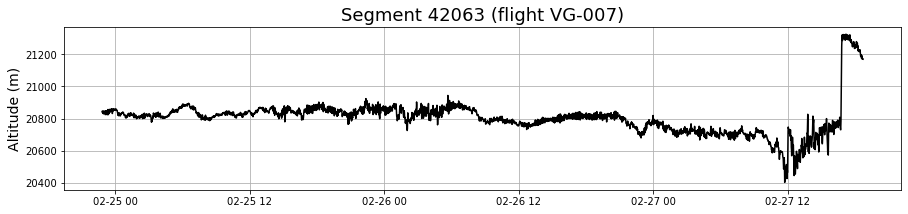

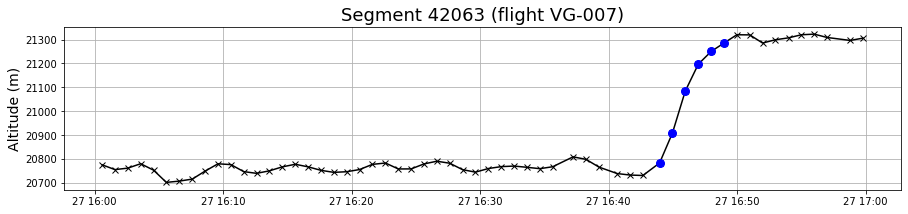

In [92]:
# Lists of segments
possible_maneuvering = np.array([136,169,272,1054,1714,3231,3279,6100,6102,8259,8348,9525,9526,13114,13843,14771,
                                 14772,15907,16764,18233,18330,22784,22800,42063,84758,94830,191739])
small_maneuvering_segments = np.array([1054,7344,8348,14772,15907,18233,22800,31210,42063,42337,50898,55810,94830,
                                       199048,261301,267823,270099])

# Look at one segment
segment_id = 42063
segment = flights[flights.segment_id == segment_id]
#temp = segment[segment.exceeds_thresh > 0]

plt.figure(figsize=(15,3))
plt.plot(segment.time,segment.altitude,'k')
#plt.plot(temp.time,temp.altitude,'ro',markersize=8)
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Altitude (m)', fontsize=14);

# Zoom in on the spike, marking its location to be referenced later
time_start = np.datetime64('2017-02-27 16:00')
time_stop =  np.datetime64('2017-02-27 17:00')

plt.figure(figsize=(15,3))
temp = segment[segment.time >= time_start]
temp = temp[temp.time < time_stop]
plt.plot(temp.time,temp.altitude,'-kx')
plt.plot(temp.loc[19257485:19257490,'time'],temp.loc[19257485:19257490,'altitude'],'bo',markersize=8)
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Altitude (m)', fontsize=14);

temp.index.min(), temp.index.max(), segment.time.dt.year.iloc[0]

In [93]:
# From the segments identified in the previous steps, note the indices when there's maneuvering,
# and print out the timestamps flight IDs so the maneuvering can be removed independently of the
# segment ID, which might change if I make changes to code upstream of this processing

# Takeoffs:
# These are often not takeoffs, but altitude increases at the start of a segment
print('Takeoffs:')
print('')

# Segment 268 (Flight I-162)
print(flights.loc[[597653,597742],['flight_id','time']])
print('')

# Segment 272 (Flight I-162)
print(flights.loc[[610529,610578],['flight_id','time']])
print('')

# Segment 1701 (Flight I-252)
print(flights.loc[[2795301,2795364],['flight_id','time']])
print('')

# Segment 1711 (Flight I-252)
print(flights.loc[[2809662,2809816],['flight_id','time']])
print('')

# Segment 1714 (Flight I-252)
print(flights.loc[[2815413,2815490],['flight_id','time']])
print('')

# Segment 3231 (Flight I-283)
print(flights.loc[[5294523,5294565],['flight_id','time']])
print('')

# Segment 3279 (Flight I-283)
print(flights.loc[[5362039,5362114],['flight_id','time']])
print('')

# Segment 9526 (Flight NR-215)
print(flights.loc[[11012943,11012979],['flight_id','time']])
print('')



# Landings:
# These are often not landings, but altitude decreases at the end of a segment
print('Landings:')
print('')

# Segment 167 (Flight L-002)
print(flights.loc[[255035,255054],['flight_id','time']])
print('')

# Segment 169 (Flight L-002)
print(flights.loc[[264988,265072],['flight_id','time']])
print('')

# Segment 6100 (Flight I-383)
print(flights.loc[[9381487,9381497],['flight_id','time']])
print('')

# Segment 6102 (Flight I-384)
print(flights.loc[[9385580,9385587],['flight_id','time']])
print('')

# Segment 6453 (Flight I-426)
print(flights.loc[[9611962,9611980],['flight_id','time']])
print('')

# Segment 9525 (Flight NR-214)
print(flights.loc[[11012936,11012942],['flight_id','time']])
print('')

# Segment 13843 (Flight O-106)
print(flights.loc[[12122483,12122588],['flight_id','time']])
print('')

# Segment 14771 (Flight O-122)
print(flights.loc[[12361962,12361978],['flight_id','time']])
print('')

# Segment 191739 (Flight LN-228)
print(flights.loc[[40678791,40678814],['flight_id','time']])
print('')



# Large maneuvers:
print('Large maneuvers:')
print('')

# Segment 136 (Flight I-126)
print(flights.loc[[156296,156352],['flight_id','time']]) 
print('')
print(flights.loc[[157713,157744],['flight_id','time']])
print('')

# Segment 5835 (Flight I-357)
print(flights.loc[[8836286,8836505],['flight_id','time']])
print('')

# Segment 8259 (Flight I-483)
print(flights.loc[[10554335,10554427],['flight_id','time']])
print('')

# Segment 13114 (Flight O-093)
print(flights.loc[[11921101,11921289],['flight_id','time']])
print('')

# Segment 18330 (Flight O-192)
print(flights.loc[[13286930,13286962],['flight_id','time']])
print('')

# Segment 22784 (Flight O-266)
print(flights.loc[[14387350,14387356],['flight_id','time']])
print('')

# Segment 84758 (Flight P-518)
print(flights.loc[[30265091,30265119],['flight_id','time']])
print('')



# Smaller altitude jumps
print('Smaller altitude jumps:')
print('')

# Segment 1054 (Flight I-230)
print(flights.loc[[1807633,1807639],['flight_id','time']]) 
print('')

# Segment 7344 (Flight M-054)
print(flights.loc[[10182637],['flight_id','time']]) 
print('')

# Segment 8348 (Flight I-487)
print(flights.loc[[10592380,10592382],['flight_id','time']]) 
print('')

# Segment 14772 (Flight O-122)
print(flights.loc[[12384151,12384153],['flight_id','time']]) 
print('')

# Segment 15907 (Flight O-143)
print(flights.loc[[12661355,12661357],['flight_id','time']]) 
print('')

# Segment 18233 (Flight O-188)
print(flights.loc[[13266127,13266128],['flight_id','time']]) 
print('')

# Segment 22800 (Flight O-266)
print(flights.loc[[14401842,14401845],['flight_id','time']]) 
print('')

# Segment 31210 (Flight OL-100)
print(flights.loc[[16416182,16416189],['flight_id','time']]) 
print('')

# Segment 42063 (Flight VG-007)
print(flights.loc[[19257485,19257490],['flight_id','time']]) 
print('')

# Segment 42337 (Flight P-078)
print(flights.loc[[19336325,19336350],['flight_id','time']]) 
print('')

# Segment 50898 (Flight P-234)
print(flights.loc[[21776686,21776689],['flight_id','time']]) 
print('')

# Segment 55810 (Flight P-423)
print(flights.loc[[23136836,23136987],['flight_id','time']]) 
print('')

# Segment 94830 (Flight P-663; the first jump)
print(flights.loc[[32741512,32741554],['flight_id','time']]) 
print('')

# Segment 94830 (Flight P-663; the second jump)
print(flights.loc[[32743510,32743522],['flight_id','time']]) 
print('')

# Segment 199048 (Flight LN-257)
print(flights.loc[[41111416,41111420],['flight_id','time']]) 
print('')

# Segment 261301 (Flight LN-286)
print(flights.loc[[42147822,42147997],['flight_id','time']]) 
print('')

# Segment 267823 (Flight LN-318)
print(flights.loc[[42693063,42693130],['flight_id','time']]) 
print('')

# Segment 270099 (Flight LN-324)
print(flights.loc[[43060450,43060465],['flight_id','time']]) 
print('')







# Output from the above code:
# DO NOT CHANGE

#Takeoffs:
#
#       flight_id                    time
#597653     I-162 2014-03-28 05:03:40.419
#597742     I-162 2014-03-28 06:34:40.429
#
#       flight_id                    time
#610529     I-162 2014-05-10 05:09:26.699
#610578     I-162 2014-05-10 06:00:26.710
#
#        flight_id                time
#2795301     I-252 2014-07-16 07:13:12
#2795364     I-252 2014-07-16 08:16:12
#
#        flight_id                time
#2809662     I-252 2014-07-28 02:58:27
#2809816     I-252 2014-07-28 05:32:27
#
#        flight_id                time
#2815413     I-252 2014-08-01 06:54:32
#2815490     I-252 2014-08-01 08:11:32
#
#        flight_id                    time
#5294523     I-283 2014-08-01 19:20:39.773
#5294565     I-283 2014-08-01 20:02:39.781
#
#        flight_id                    time
#5362039     I-283 2014-09-22 03:28:18.660
#5362114     I-283 2014-09-22 04:43:19.660
#
#         flight_id                time
#11012943    NR-215 2016-02-09 06:51:56
#11012979    NR-215 2016-02-09 07:28:22
#
#Landings:
#
#       flight_id                    time
#255035     L-002 2014-02-11 18:32:42.609
#255054     L-002 2014-02-11 19:22:42.609
#
#       flight_id                    time
#264988     L-002 2014-03-03 16:24:25.281
#265072     L-002 2014-03-03 19:35:25.273
#
#        flight_id                    time
#9381487     I-383 2014-10-04 19:19:43.289
#9381497     I-383 2014-10-04 19:29:43.289
#
#        flight_id                    time
#9385580     I-384 2014-10-04 17:54:40.160
#9385587     I-384 2014-10-04 18:01:41.160
#
#        flight_id                    time
#9611962     I-426 2015-04-07 20:19:45.109
#9611980     I-426 2015-04-07 21:13:49.109
#
#         flight_id                time
#11012936    NR-214 2016-03-05 03:41:18
#11012942    NR-214 2016-03-05 04:42:03
#
#         flight_id                time
#12122483     O-106 2017-03-06 03:47:24
#12122588     O-106 2017-03-06 05:35:58
#
#         flight_id                time
#12361962     O-122 2017-01-04 19:23:44
#12361978     O-122 2017-01-04 19:40:03
#
#         flight_id                time
#40678791    LN-228 2020-11-23 16:06:34
#40678814    LN-228 2020-11-23 16:19:47
#
#Large maneuvers:
#
#       flight_id                    time
#156296     I-126 2013-12-24 19:29:56.593
#156352     I-126 2013-12-24 20:25:56.601
#
#       flight_id                    time
#157713     I-126 2013-12-25 19:13:56.773
#157744     I-126 2013-12-25 19:44:56.781
#
#        flight_id                    time
#8836286     I-357 2014-10-30 21:58:07.187
#8836505     I-357 2014-10-31 08:55:07.189
#
#         flight_id                    time
#10554335     I-483 2015-05-26 13:30:43.691
#10554427     I-483 2015-05-26 18:17:07.703
#
#         flight_id                time
#11921101     O-093 2017-03-27 01:23:21
#11921289     O-093 2017-03-27 04:40:25
#
#         flight_id                time
#13286930     O-192 2017-03-13 06:52:57
#13286962     O-192 2017-03-13 07:26:13
#
#         flight_id                time
#14387350     O-266 2017-06-03 20:49:44
#14387356     O-266 2017-06-03 20:59:00
#
#         flight_id                time
#30265091     P-518 2019-03-12 09:51:54
#30265119     P-518 2019-03-12 10:13:06
#
#Smaller altitude jumps:
#
#        flight_id                time
#1807633     I-230 2014-08-12 18:46:36
#1807639     I-230 2014-08-12 18:52:36
#
#         flight_id                    time
#10182637     M-054 2015-01-14 17:38:05.109
#
#         flight_id                    time
#10592380     I-487 2015-07-04 08:27:42.359
#10592382     I-487 2015-07-04 08:34:21.359
#
#         flight_id                time
#12384151     O-122 2017-01-21 00:41:48
#12384153     O-122 2017-01-21 00:43:48
#
#         flight_id                time
#12661355     O-143 2017-01-17 03:12:17
#12661357     O-143 2017-01-17 03:14:17
#
#         flight_id                time
#13266127     O-188 2017-03-05 06:33:38
#13266128     O-188 2017-03-05 06:34:38
#
#         flight_id                time
#14401842     O-266 2017-06-17 04:21:45
#14401845     O-266 2017-06-17 04:24:46
#
#         flight_id                time
#16416182    OL-100 2017-06-25 11:02:16
#16416189    OL-100 2017-06-25 11:09:17
#
#         flight_id                time
#19257485    VG-007 2017-02-27 16:43:58
#19257490    VG-007 2017-02-27 16:48:59
#
#         flight_id                time
#19336325     P-078 2018-01-07 08:46:27
#19336350     P-078 2018-01-07 09:13:13
#
#         flight_id                time
#21776686     P-234 2018-05-22 20:44:53
#21776689     P-234 2018-05-22 20:46:53
#
#         flight_id                time
#23136836     P-423 2018-10-17 03:08:19
#23136987     P-423 2018-10-17 04:45:55
#
#         flight_id                time
#32741512     P-663 2019-09-29 16:50:11
#32741554     P-663 2019-09-29 17:21:26
#
#         flight_id                time
#32743510     P-663 2019-09-30 18:46:52
#32743522     P-663 2019-09-30 18:57:03
#
#         flight_id                time
#41111416    LN-257 2020-10-05 22:44:13
#41111420    LN-257 2020-10-05 22:47:14
#
#         flight_id                time
#42147822    LN-286 2021-04-01 04:47:53
#42147997    LN-286 2021-04-01 07:06:49
#
#         flight_id                time
#42693063    LN-318 2021-01-20 09:16:02
#42693130    LN-318 2021-01-20 10:07:25
#
#         flight_id                time
#43060450    LN-324 2021-03-08 10:18:40
#43060465    LN-324 2021-03-08 10:30:17

Takeoffs:

       flight_id                    time
597653     I-162 2014-03-28 05:03:40.419
597742     I-162 2014-03-28 06:34:40.429

       flight_id                    time
610529     I-162 2014-05-10 05:09:26.699
610578     I-162 2014-05-10 06:00:26.710

        flight_id                time
2795301     I-252 2014-07-16 07:13:12
2795364     I-252 2014-07-16 08:16:12

        flight_id                time
2809662     I-252 2014-07-28 02:58:27
2809816     I-252 2014-07-28 05:32:27

        flight_id                time
2815413     I-252 2014-08-01 06:54:32
2815490     I-252 2014-08-01 08:11:32

        flight_id                    time
5294523     I-283 2014-08-01 19:20:39.773
5294565     I-283 2014-08-01 20:02:39.781

        flight_id                    time
5362039     I-283 2014-09-22 03:28:18.660
5362114     I-283 2014-09-22 04:43:19.660

         flight_id                time
11012943    NR-215 2016-02-09 06:51:56
11012979    NR-215 2016-02-09 07:28:22

Landings:

       flight

Number of segments: 41


/var/folders/dw/3jtpv5j16bv77dfbt2nw04780000gp/T/ipykernel_1935/2144833875.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15,3))


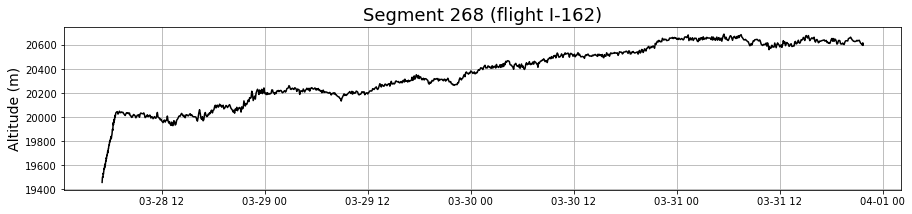

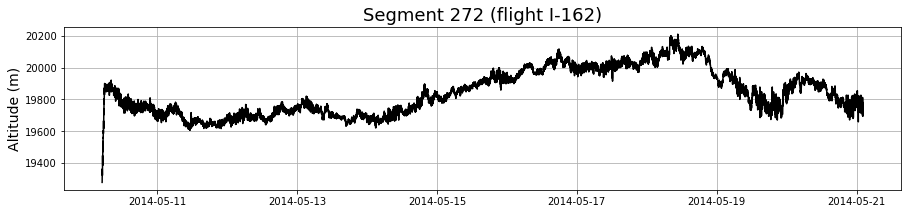

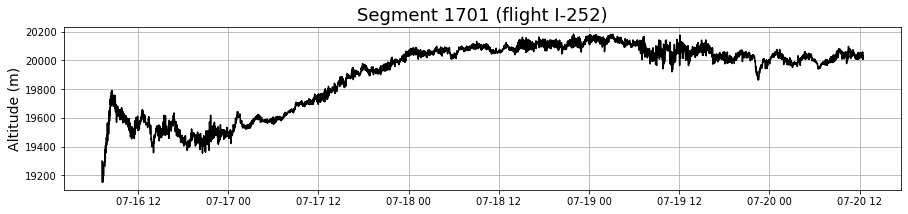

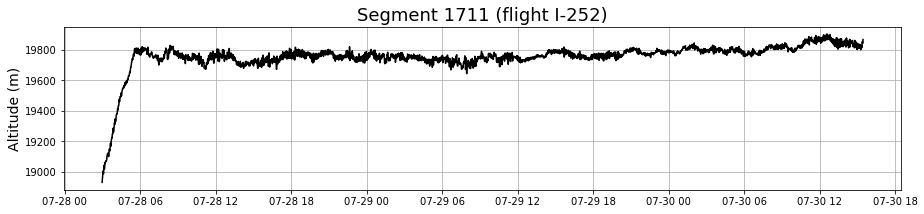

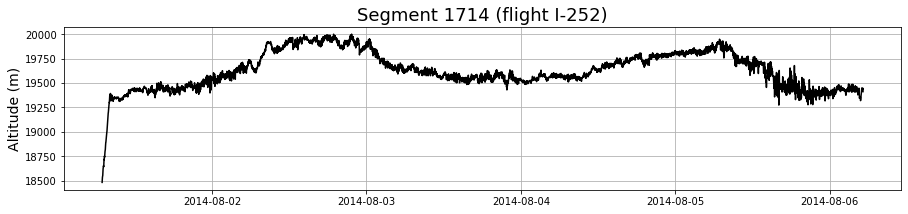

...

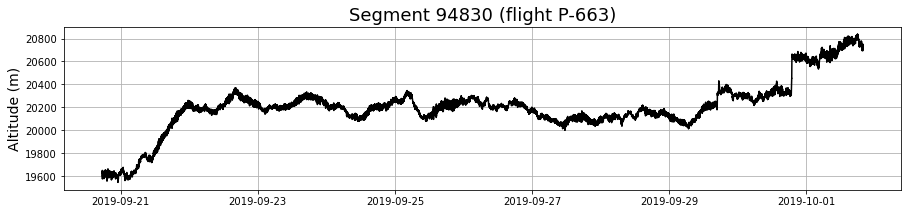

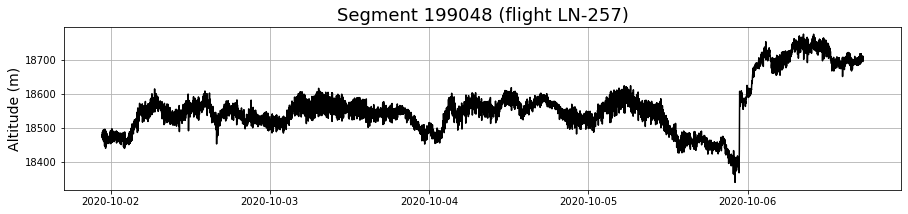

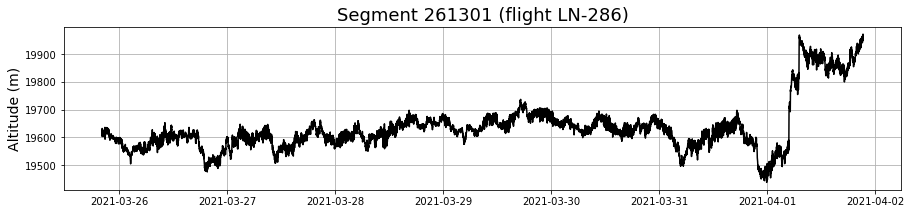

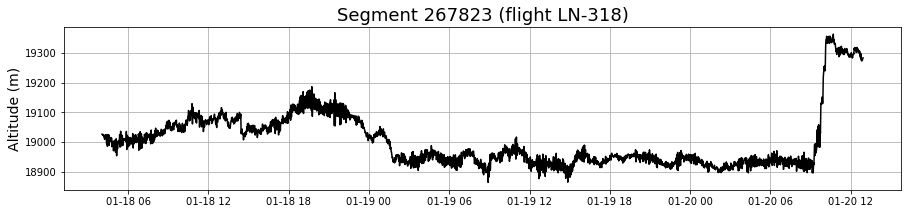

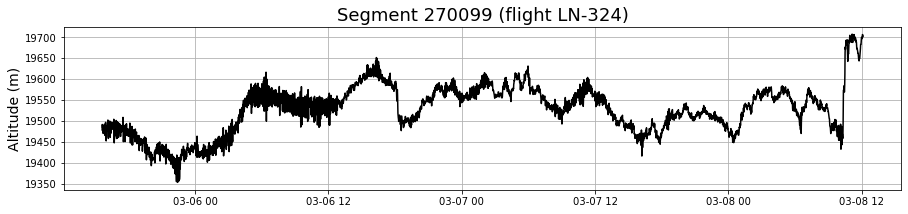

In [94]:
# Plot all the segments I'm changing
segment_ids = np.array([268,272,1701,1711,1714,3231,3279,9526,167,169,6100,
                        6102,6453,9525,13843,14771,191739,136,5835,8259,
                        13114,18330,22784,84758,1054,7344,8348,14772,15907,
                        18233,22800,31210,42063,42337,50898,55810,94830,
                        199048,261301,267823,270099])
n_segments = segment_ids.size
print('Number of segments:', n_segments)

# Plot all of these segments
for i in np.arange(n_segments):
    
    segment = flights[flights.segment_id == segment_ids[i]].copy()
    
    plt.figure(figsize=(15,3))
    plt.plot(segment.time,segment.altitude,'k')
    plt.grid()
    plt.title(f'Segment {segment_ids[i]} (flight {segment.flight_id.iloc[0]})', fontsize=18)
    plt.ylabel('Altitude (m)', fontsize=14);

In [3]:
# Label the maneuvering

def segments_from_maneuvering(segment):
    
    # Create a counter so that the segment ID is incremented across the flights, creating unique segment IDs
    if "counter" not in segments_from_maneuvering.__dict__:
        segments_from_maneuvering.counter = 0
        
    # Each time maneuvering stops, a new segment begins:
    segment['segment_id_new'] = (segment.maneuvering.diff() == -1).astype(int).cumsum()
    n_segments = segment.segment_id_new.max() + 1 # the segments start at zero
    
    # Delete any data points where maneuvering is happening
    segment = segment[segment.maneuvering==0]
    
    # Apply the counter and increment it
    segment.segment_id_new = segment.segment_id_new + segments_from_maneuvering.counter
    segments_from_maneuvering.counter = segments_from_maneuvering.counter + n_segments
    
    return segment

flights['maneuvering'] = 0

# Segment 230 (Flight I-152) # There's a large gap in the wind data at the end of this segment;
# mark it as maneuvering
flights.loc[(flights.flight_id == 'I-152') & 
        (flights.time >= np.datetime64('2014-06-01 05:00')) &
        (flights.time <= np.datetime64('2014-06-06 11:00')), 'maneuvering'] = 1



# Takeoffs:

# Segment 268 (Flight I-162)
flights.loc[(flights.flight_id == 'I-162') & 
        (flights.time >= np.datetime64('2014-03-28 05:03:40.419')) &
        (flights.time <= np.datetime64('2014-03-28 06:34:40.429')), 'maneuvering'] = 1

# Segment 272 (Flight I-162)
flights.loc[(flights.flight_id == 'I-162') & 
        (flights.time >= np.datetime64('2014-05-10 05:09:26.699')) &
        (flights.time <= np.datetime64('2014-05-10 06:00:26.710')), 'maneuvering'] = 1

# Segment 1701 (Flight I-252)
flights.loc[(flights.flight_id == 'I-252') & 
        (flights.time >= np.datetime64('2014-07-16 07:13:12')) &
        (flights.time <= np.datetime64('2014-07-16 08:16:12')), 'maneuvering'] = 1

# Segment 1711 (Flight I-252)
flights.loc[(flights.flight_id == 'I-252') & 
        (flights.time >= np.datetime64('2014-07-28 02:58:27')) &
        (flights.time <= np.datetime64('2014-07-28 05:32:27')), 'maneuvering'] = 1

# Segment 1714 (Flight I-252)
flights.loc[(flights.flight_id == 'I-252') & 
        (flights.time >= np.datetime64('2014-08-01 06:54:32')) &
        (flights.time <= np.datetime64('2014-08-01 08:11:32')), 'maneuvering'] = 1

# Segment 3231 (Flight I-283)
flights.loc[(flights.flight_id == 'I-283') & 
        (flights.time >= np.datetime64('2014-08-01 19:20:39.773')) &
        (flights.time <= np.datetime64('2014-08-01 20:02:39.781')), 'maneuvering'] = 1

# Segment 3279 (Flight I-283)
flights.loc[(flights.flight_id == 'I-283') & 
        (flights.time >= np.datetime64('2014-09-22 03:28:18.660')) &
        (flights.time <= np.datetime64('2014-09-22 04:43:19.660')), 'maneuvering'] = 1

# Segment 9526 (Flight NR-215)
flights.loc[(flights.flight_id == 'NR-215') & 
        (flights.time >= np.datetime64('2016-02-09 06:51:56')) &
        (flights.time <= np.datetime64('2016-02-09 07:28:22')), 'maneuvering'] = 1



# Landings:

# Segment 167 (Flight L-002)
flights.loc[(flights.flight_id == 'L-002') & 
        (flights.time >= np.datetime64('2014-02-11 18:32:42.609')) &
        (flights.time <= np.datetime64('2014-02-11 19:22:42.609')), 'maneuvering'] = 1

# Segment 169 (Flight L-002)
flights.loc[(flights.flight_id == 'L-002') & 
        (flights.time >= np.datetime64('2014-03-03 16:24:25.281')) &
        (flights.time <= np.datetime64('2014-03-03 19:35:25.273')), 'maneuvering'] = 1

# Segment 6100 (Flight I-383)
flights.loc[(flights.flight_id == 'I-383') & 
        (flights.time >= np.datetime64('2014-10-04 19:19:43.289')) &
        (flights.time <= np.datetime64('2014-10-04 19:29:43.289')), 'maneuvering'] = 1

# Segment 6102 (Flight I-384)
flights.loc[(flights.flight_id == 'I-384') & 
        (flights.time >= np.datetime64('2014-10-04 17:54:40.160')) &
        (flights.time <= np.datetime64('2014-10-04 18:01:41.160')), 'maneuvering'] = 1

# Segment 6453 (Flight I-426)
flights.loc[(flights.flight_id == 'I-426') & 
        (flights.time >= np.datetime64('2015-04-07 20:19:45.109')) &
        (flights.time <= np.datetime64('2015-04-07 21:13:49.109')), 'maneuvering'] = 1

# Segment 9525 (Flight NR-214)
flights.loc[(flights.flight_id == 'NR-214') & 
        (flights.time >= np.datetime64('2016-03-05 03:41:18')) &
        (flights.time <= np.datetime64('2016-03-05 04:42:03')), 'maneuvering'] = 1

# Segment 13843 (Flight O-106)
flights.loc[(flights.flight_id == 'O-106') & 
        (flights.time >= np.datetime64('2017-03-06 03:47:24')) &
        (flights.time <= np.datetime64('2017-03-06 05:35:58')), 'maneuvering'] = 1

# Segment 14771 (Flight O-122)
flights.loc[(flights.flight_id == 'O-122') & 
        (flights.time >= np.datetime64('2017-01-04 19:23:44')) &
        (flights.time <= np.datetime64('2017-01-04 19:40:03')), 'maneuvering'] = 1

# Segment 191739 (Flight LN-228)
flights.loc[(flights.flight_id == 'LN-228') & 
        (flights.time >= np.datetime64('2020-11-23 16:06:34')) &
        (flights.time <= np.datetime64('2020-11-23 16:19:47')), 'maneuvering'] = 1



# Big maneuvers:

# Segment 136 (Flight I-126)
flights.loc[(flights.flight_id == 'I-126') & 
        (flights.time >= np.datetime64('2013-12-24 19:29:56.593')) &
        (flights.time <= np.datetime64('2013-12-24 20:25:56.601')), 'maneuvering'] = 1

# Segment 136 (Flight I-126)
flights.loc[(flights.flight_id == 'I-126') & 
        (flights.time >= np.datetime64('2013-12-25 19:13:56.773')) &
        (flights.time <= np.datetime64('2013-12-25 19:44:56.781')), 'maneuvering'] = 1

# Segment 5835 (Flight I-357)
flights.loc[(flights.flight_id == 'I-357') & 
        (flights.time >= np.datetime64('2014-10-30 21:58:07.187')) &
        (flights.time <= np.datetime64('2014-10-31 08:55:07.189')), 'maneuvering'] = 1

# Segment 8259 (Flight I-483)
flights.loc[(flights.flight_id == 'I-483') & 
        (flights.time >= np.datetime64('2015-05-26 13:30:43.691')) &
        (flights.time <= np.datetime64('2015-05-26 18:17:07.703')), 'maneuvering'] = 1

# Segment 13114 (Flight O-093)
flights.loc[(flights.flight_id == 'O-093') & 
        (flights.time >= np.datetime64('2017-03-27 01:23:21')) &
        (flights.time <= np.datetime64('2017-03-27 04:40:25')), 'maneuvering'] = 1

# Segment 18330 (Flight O-192)
flights.loc[(flights.flight_id == 'O-192') & 
        (flights.time >= np.datetime64('2017-03-13 06:52:57')) &
        (flights.time <= np.datetime64('2017-03-13 07:26:13')), 'maneuvering'] = 1

# Segment 22784 (Flight O-266)
flights.loc[(flights.flight_id == 'O-266') & 
        (flights.time >= np.datetime64('2017-06-03 20:49:44')) &
        (flights.time <= np.datetime64('2017-06-03 20:59:00')), 'maneuvering'] = 1

# Segment 84758 (Flight P-518)
flights.loc[(flights.flight_id == 'P-518') & 
        (flights.time >= np.datetime64('2019-03-12 09:51:54')) &
        (flights.time <= np.datetime64('2019-03-12 10:13:06')), 'maneuvering'] = 1



# Smaller altitude jumps:

# Segment 1054 (Flight I-230)
flights.loc[(flights.flight_id == 'I-230') & 
        (flights.time >= np.datetime64('2014-08-12 18:46:36')) &
        (flights.time <= np.datetime64('2014-08-12 18:52:36')), 'maneuvering'] = 1

# Segment 7344 (Flight M-054)
flights.loc[(flights.flight_id == 'M-054') & 
        (flights.time == np.datetime64('2015-01-14 17:38:05.109')), 'maneuvering'] = 1

# Segment 8348 (Flight I-487)
flights.loc[(flights.flight_id == 'I-487') & 
        (flights.time >= np.datetime64('2015-07-04 08:27:42.359')) &
        (flights.time <= np.datetime64('2015-07-04 08:34:21.359')), 'maneuvering'] = 1

# Segment 14772 (Flight O-122)
flights.loc[(flights.flight_id == 'O-122') & 
        (flights.time >= np.datetime64('2017-01-21 00:41:48')) &
        (flights.time <= np.datetime64('2017-01-21 00:43:48')), 'maneuvering'] = 1

# Segment 15907 (Flight O-143)
flights.loc[(flights.flight_id == 'O-143') & 
        (flights.time >= np.datetime64('2017-01-17 03:12:17')) &
        (flights.time <= np.datetime64('2017-01-17 03:14:17')), 'maneuvering'] = 1

# Segment 18233 (Flight O-188)
flights.loc[(flights.flight_id == 'O-188') & 
        (flights.time >= np.datetime64('2017-03-05 06:33:38')) &
        (flights.time <= np.datetime64('2017-03-05 06:34:38')), 'maneuvering'] = 1

# Segment 22800 (Flight O-266)
flights.loc[(flights.flight_id == 'O-266') & 
        (flights.time >= np.datetime64('2017-06-17 04:21:45')) &
        (flights.time <= np.datetime64('2017-06-17 04:24:46')), 'maneuvering'] = 1

# Segment 31210 (Flight OL-100)
flights.loc[(flights.flight_id == 'OL-100') & 
        (flights.time >= np.datetime64('2017-06-25 11:02:16')) &
        (flights.time <= np.datetime64('2017-06-25 11:09:17')), 'maneuvering'] = 1

# Segment 42063 (Flight VG-007)
flights.loc[(flights.flight_id == 'VG-007') & 
        (flights.time >= np.datetime64('2017-02-27 16:43:58')) &
        (flights.time <= np.datetime64('2017-02-27 16:48:59')), 'maneuvering'] = 1

# Segment 42337 (Flight P-078)
flights.loc[(flights.flight_id == 'P-078') & 
        (flights.time >= np.datetime64('2018-01-07 08:46:27')) &
        (flights.time <= np.datetime64('2018-01-07 09:13:13')), 'maneuvering'] = 1

# Segment 50898 (Flight P-234)
flights.loc[(flights.flight_id == 'P-234') & 
        (flights.time >= np.datetime64('2018-05-22 20:44:53')) &
        (flights.time <= np.datetime64('2018-05-22 20:46:53')), 'maneuvering'] = 1

# Segment 55810 (Flight P-423)
flights.loc[(flights.flight_id == 'P-423') & 
        (flights.time >= np.datetime64('2018-10-17 03:08:19')) &
        (flights.time <= np.datetime64('2018-10-17 04:45:55')), 'maneuvering'] = 1

# Segment 94830 (Flight P-663; the first jump) 
flights.loc[(flights.flight_id == 'P-663') & 
        (flights.time >= np.datetime64('2019-09-29 16:50:11')) &
        (flights.time <= np.datetime64('2019-09-29 17:21:26')), 'maneuvering'] = 1

# Segment 94830 (Flight P-663; the second jump)
flights.loc[(flights.flight_id == 'P-663') & 
        (flights.time >= np.datetime64('2019-09-30 18:46:52')) &
        (flights.time <= np.datetime64('2019-09-30 18:57:03')), 'maneuvering'] = 1

# Segment 199048 (Flight LN-257)
flights.loc[(flights.flight_id == 'LN-257') & 
        (flights.time >= np.datetime64('2020-10-05 22:44:13')) &
        (flights.time <= np.datetime64('2020-10-05 22:47:14')), 'maneuvering'] = 1

# Segment 261301 (Flight LN-286)
flights.loc[(flights.flight_id == 'LN-286') & 
        (flights.time >= np.datetime64('2021-04-01 04:47:53')) &
        (flights.time <= np.datetime64('2021-04-01 07:06:49')), 'maneuvering'] = 1

# Segment 267823 (Flight LN-318)
flights.loc[(flights.flight_id == 'LN-318') & 
        (flights.time >= np.datetime64('2021-01-20 09:16:02')) &
        (flights.time <= np.datetime64('2021-01-20 10:07:25')), 'maneuvering'] = 1

# Segment 270099 (Flight LN-324)
flights.loc[(flights.flight_id == 'LN-324') & 
        (flights.time >= np.datetime64('2021-03-08 10:18:40')) &
        (flights.time <= np.datetime64('2021-03-08 10:30:17')), 'maneuvering'] = 1



flights = flights.groupby('segment_id').progress_apply(segments_from_maneuvering).reset_index(drop=True)
print(flights.segment_id.nunique(), flights.segment_id_new.nunique())

  0%|          | 0/124073 [00:00<?, ?it/s]

124073 124099


### In the course of those previous checks, several segments have obviously bad data; note them for deletion

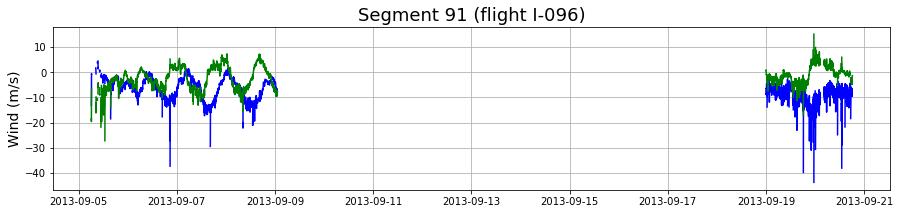

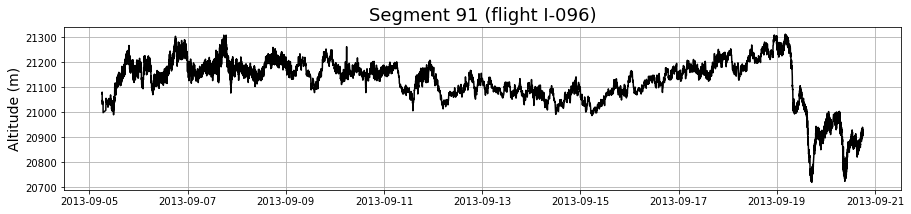

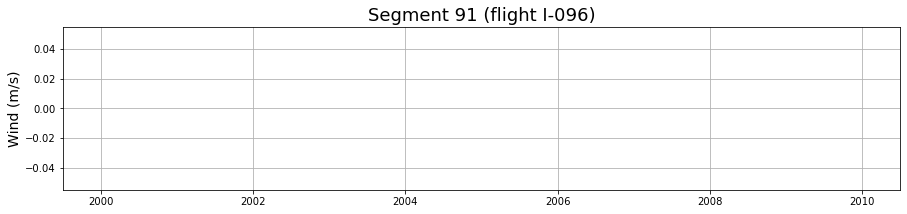

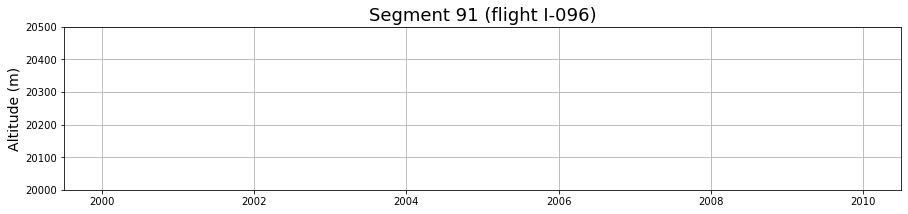

In [4]:
# List of segments to delete
# Segment ID:   Reason:
# 64            Bad wind data
# 73            Bad wind data
# 91            Bad wind data
# 100           Bad wind data
# 104           Bad wind data
# 108           Bad wind data
# 114           Bad wind data
# 116           Bad wind data
# 118           Bad altitude, wind data
# 120           Bad wind data
# 122           Bad altitude, wind data
# 130           Bad wind data
# 132           Bad wind data
# 164           Too short, bad wind data
# 173           Bad altitude, wind data
# 9480          Bad altitude data
# 9525          Bad altitude data, too short wind data
# 9923          Bad altitude data
# 10289         Bad altitude data

# Look at one segment
segment_id = 91
segment = flights[flights.segment_id == segment_id].copy()

plt.figure(figsize=(15,3))
plt.plot(segment.time,segment.wind_u,'b')
plt.plot(segment.time,segment.wind_v,'g')
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Wind (m/s)', fontsize=14);

plt.figure(figsize=(15,3))
plt.plot(segment.time,segment.altitude,'k')
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Altitude (m)', fontsize=14);

# Zoom in on the spike, marking its location to be referenced later
time_start = np.datetime64('2016-02-24 00:00')
time_stop =  np.datetime64('2016-03-05 00:00')

plt.figure(figsize=(15,3))
temp = segment[segment.time >= time_start]
temp = temp[temp.time < time_stop]
plt.plot(temp.time,temp.wind_u,'-bx')
plt.plot(temp.time,temp.wind_v,'-gx')
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Wind (m/s)', fontsize=14);

plt.figure(figsize=(15,3))
plt.plot(temp.time,temp.altitude,'-kx')
plt.grid()
plt.ylim(20000,20500)
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Altitude (m)', fontsize=14);

In [4]:
# Delete the segments with bad data

segments_to_delete = np.array([64,73,91,100,104,108,114,116,118,120,122,130,132,164,173,9480,9525,9923,10289])

num_before = flights.segment_id.nunique()
flights = flights[~flights.segment_id.isin(segments_to_delete)].reset_index(drop=True)
print(f'Removed {num_before-flights.segment_id.nunique()}/{num_before} segments with bad data')

Removed 19/124073 segments with bad data


### Save the data

In [5]:
flights = flights.drop(columns = ['suspicious_motion','maneuvering']).reset_index(drop=True)
flights = flights.rename(columns={'segment_id': 'segment_id_old', 'segment_id_new': 'segment_id'})
flights.to_feather('4b_extra_maneuvering.feather')
flights